In [1]:
import os
import pandas as pd
#import io
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('stopwords')
import string
import numpy as np
from gensim import corpora
import gensim
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
import matplotlib.pyplot as plt
import pyLDAvis.gensim_models
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\bened\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### January Data

###### whole january

In [6]:
path='January2022/'

In [7]:
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Jan22 = f.read().replace('\n','')

In [8]:
Jan22

'Young people who lost their jobs during the pandemic in the UK have returned to less secure work, often in gig economy roles, according to research from a leading thinktank, which also found almost 50,000 more men under the age of 24 are now economically inactive. A report by the Resolution Foundation published on Monday found young people had returned to work rapidly in late 2021, with unemployment now slightly lower than pre-pandemic levels, but a third of the 18- to 34-year-olds back in the workplace were now in atypical, insecure work. The young “returners” – those who were employed pre-Covid but became unemployed in the pandemic – were now much more likely than those who stayed in work to be on a temporary or zero-hours contract, or doing agency work or unsteady hours. Thirty-three per cent of the returners, among 6,100 people surveyed by YouGov for the study, were now in such roles, compared with 12% of those who had stayed in work throughout the pandemic. While the thinktank sa

###### january weekly

In [9]:
path='Jan_first_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Jan_first_week = f.read().replace('\n','')

In [10]:
Jan_first_week

'Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.The government’s plans for a post-Brexit scheme to support British farming are based on little more than “blind o

In [27]:
path='Jan_second_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Jan_second_week = f.read().replace('\n','')

In [28]:
Jan_second_week

'Novelist Deborah Levy first discovered writing as a kind of therapy when her voice disappeared as a child, she has revealed. Appearing on BBC Radio 4’s Desert Island Discs, the popular British writer, acclaimed for her Booker Prize-shortlisted novels Swimming Home and Hot Milk, said her voice gradually got quieter during her schooldays in South Africa. Born there in 1959, Levy was the eldest child of anti-apartheid activists Norman and Philippa Levy and when her father was arrested five years later, she became almost silent in response to the stress. “It’s curious. I wasn’t exactly a mute; it was just the volume of my voice got lower and lower and lower until no one could hear me,” she said. “The kids at school used to say to me, ‘are you dumb?’, and I used to nod because they would leave me alone.” Her father was held in prison for four years and her silence became a habit. Levy, now 62, recalled: “It was really about being totally overwhelmed by everything, not believing that my tho

In [29]:
path='Jan_third_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Jan_third_week = f.read().replace('\n','')

In [30]:
Jan_third_week

'Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Tech stocks have been nursing a new year hangover, pushing the Nasdaq into correction territory. Momentum is buil

In [33]:
path='Jan_fourth_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Jan_fourth_week = f.read().replace('\n','')

In [34]:
Jan_fourth_week

'Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual. This page was initially published with an incorrect headline and an old Azed grid. This was amended on 30 Januar

### LDA Modelling - setting stop words, string punctuation, Lemmatizing

In [2]:
stop=set(stopwords.words('english'))
exclude=set(string.punctuation)
lemma=WordNetLemmatizer()

In [3]:
stop2=("people","don't","\"the","said.","said:","it’s"," said","–","-","0o", "0s", "3a", "3b", "3d", "6b", "6o", "a", "a1", "a2", "a3", "a4", "ab", "able", "about", "above", "abst", "ac", "accordance", "according", "accordingly", "across", "act", "actually", "ad", "added", "adj", "ae", "af", "affected", "affecting", "affects", "after", "afterwards", "ag", "again", "against", "ah", "ain", "ain't", "aj", "al", "all", "allow", "allows", "almost", "alone", "along", "already", "also", "although", "always", "am", "among", "amongst", "amoungst", "amount", "an", "and", "announce", "another", "any", "anybody", "anyhow", "anymore", "anyone", "anything", "anyway", "anyways", "anywhere", "ao", "ap", "apart", "apparently", "appear", "appreciate", "appropriate", "approximately", "ar", "are", "aren", "arent", "aren't", "arise", "around", "as", "a's", "aside", "ask", "asking", "associated", "at", "au", "auth", "av", "available", "aw", "away", "awfully", "ax", "ay", "az", "b", "b1", "b2", "b3", "ba", "back", "bc", "bd", "be", "became", "because", "become", "becomes", "becoming", "been", "before", "beforehand", "begin", "beginning", "beginnings", "begins", "behind", "being", "believe", "below", "beside", "besides", "best", "better", "between", "beyond", "bi", "bill", "biol", "bj", "bk", "bl", "bn", "both", "bottom", "bp", "br", "brief", "briefly", "bs", "bt", "bu", "but", "bx", "by", "c", "c1", "c2", "c3", "ca", "call", "came", "can", "cannot", "cant", "can't", "cause", "causes", "cc", "cd", "ce", "certain", "certainly", "cf", "cg", "ch", "changes", "ci", "cit", "cj", "cl", "clearly", "cm", "c'mon", "cn", "co", "com", "come", "comes", "con", "concerning", "consequently", "consider", "considering", "contain", "containing", "contains", "corresponding", "could", "couldn", "couldnt", "couldn't", "course", "cp", "cq", "cr", "cry", "cs", "c's", "ct", "cu", "currently", "cv", "cx", "cy", "cz", "d", "d2", "da", "date", "dc", "dd", "de", "definitely", "describe", "described", "despite", "detail", "df", "di", "did", "didn", "didn't", "different", "dj", "dk", "dl", "do", "does", "doesn", "doesn't", "doing", "don", "done", "don't", "down", "downwards", "dp", "dr", "ds", "dt", "du", "due", "during", "dx", "dy", "e", "e2", "e3", "ea", "each", "ec", "ed", "edu", "ee", "ef", "effect", "eg", "ei", "eight", "eighty", "either", "ej", "el", "eleven", "else", "elsewhere", "em", "empty", "en", "end", "ending", "enough", "entirely", "eo", "ep", "eq", "er", "es", "especially", "est", "et", "et-al", "etc", "eu", "ev", "even", "ever", "every", "everybody", "everyone", "everything", "everywhere", "ex", "exactly", "example", "except", "ey", "f", "f2", "fa", "far", "fc", "few", "ff", "fi", "fifteen", "fifth", "fify", "fill", "find", "fire", "first", "five", "fix", "fj", "fl", "fn", "fo", "followed", "following", "follows", "for", "former", "formerly", "forth", "forty", "found", "four", "fr", "from", "front", "fs", "ft", "fu", "full", "further", "furthermore", "fy", "g", "ga", "gave", "ge", "get", "gets", "getting", "gi", "give", "given", "gives", "giving", "gj", "gl", "go", "goes", "going", "gone", "got", "gotten", "gr", "greetings", "gs", "gy", "h", "h2", "h3", "had", "hadn", "hadn't", "happens", "hardly", "has", "hasn", "hasnt", "hasn't", "have", "haven", "haven't", "having", "he", "hed", "he'd", "he'll", "hello", "help", "hence", "her", "here", "hereafter", "hereby", "herein", "heres", "here's", "hereupon", "hers", "herself", "hes", "he's", "hh", "hi", "hid", "him", "himself", "his", "hither", "hj", "ho", "home", "hopefully", "how", "howbeit", "however", "how's", "hr", "hs", "http", "hu", "hundred", "hy", "i", "i2", "i3", "i4", "i6", "i7", "i8", "ia", "ib", "ibid", "ic", "id", "i'd", "ie", "if", "ig", "ignored", "ih", "ii", "ij", "il", "i'll", "im", "i'm", "immediate", "immediately", "importance", "important", "in", "inasmuch", "inc", "indeed", "index", "indicate", "indicated", "indicates", "information", "inner", "insofar", "instead", "interest", "into", "invention", "inward", "io", "ip", "iq", "ir", "is", "isn", "isn't", "it", "itd", "it'd", "it'll", "its", "it's", "itself", "iv", "i've", "ix", "iy", "iz", "j", "jj", "jr", "js", "jt", "ju", "just", "k", "ke", "keep", "keeps", "kept", "kg", "kj", "km", "know", "known", "knows", "ko", "l", "l2", "la", "largely", "last", "lately", "later", "latter", "latterly", "lb", "lc", "le", "least", "les", "less", "lest", "let", "lets", "let's", "lf", "like", "liked", "likely", "line", "little", "lj", "ll", "ll", "ln", "lo", "look", "looking", "looks", "los", "lr", "ls", "lt", "ltd", "m", "m2", "ma", "made", "mainly", "make", "makes", "many", "may", "maybe", "me", "mean", "means", "meantime", "meanwhile", "merely", "mg", "might", "mightn", "mightn't", "mill", "million", "mine", "miss", "ml", "mn", "mo", "more", "moreover", "most", "mostly", "move", "mr", "mrs", "ms", "mt", "mu", "much", "mug", "must", "mustn", "mustn't", "my", "myself", "n", "n2", "na", "name", "namely", "nay", "nc", "nd", "ne", "near", "nearly", "necessarily", "necessary", "need", "needn", "needn't", "needs", "neither", "never", "nevertheless", "new", "next", "ng", "ni", "nine", "ninety", "nj", "nl", "nn", "no", "nobody", "non", "none", "nonetheless", "noone", "nor", "normally", "nos", "not", "noted", "nothing", "novel", "now", "nowhere", "nr", "ns", "nt", "ny", "o", "oa", "ob", "obtain", "obtained", "obviously", "oc", "od", "of", "off", "often", "og", "oh", "oi", "oj", "ok", "okay", "ol", "old", "om", "omitted", "on", "once", "one", "ones", "only", "onto", "oo", "op", "oq", "or", "ord", "os", "ot", "other", "others", "otherwise", "ou", "ought", "our", "ours", "ourselves", "out", "outside", "over", "overall", "ow", "owing", "own", "ox", "oz", "p", "p1", "p2", "p3", "page", "pagecount", "pages", "par", "part", "particular", "particularly", "pas", "past", "pc", "pd", "pe", "per", "perhaps", "pf", "ph", "pi", "pj", "pk", "pl", "placed", "please", "plus", "pm", "pn", "po", "poorly", "possible", "possibly", "potentially", "pp", "pq", "pr", "predominantly", "present", "presumably", "previously", "primarily", "probably", "promptly", "proud", "provides", "ps", "pt", "pu", "put", "py", "q", "qj", "qu", "que", "quickly", "quite", "qv", "r", "r2", "ra", "ran", "rather", "rc", "rd", "re", "readily", "really", "reasonably", "recent", "recently", "ref", "refs", "regarding", "regardless", "regards", "related", "relatively", "research", "research-articl", "respectively", "resulted", "resulting", "results", "rf", "rh", "ri", "right", "rj", "rl", "rm", "rn", "ro", "rq", "rr", "rs", "rt", "ru", "run", "rv", "ry", "s", "s2", "sa", "said","said", "same", "saw", "say", "saying", "says", "sc", "sd", "se", "sec", "second", "secondly", "section", "see", "seeing", "seem", "seemed", "seeming", "seems", "seen", "self", "selves", "sensible", "sent", "serious", "seriously", "seven", "several", "sf", "shall", "shan", "shan't", "she", "shed", "she'd", "she'll", "shes", "she's", "should", "shouldn", "shouldn't", "should've", "show", "showed", "shown", "showns", "shows", "si", "side", "significant", "significantly", "similar", "similarly", "since", "sincere", "six", "sixty", "sj", "sl", "slightly", "sm", "sn", "so", "some", "somebody", "somehow", "someone", "somethan", "something", "sometime", "sometimes", "somewhat", "somewhere", "soon", "sorry", "sp", "specifically", "specified", "specify", "specifying", "sq", "sr", "ss", "st", "still", "stop", "strongly", "sub", "substantially", "successfully", "such", "sufficiently", "suggest", "sup", "sure", "sy", "system", "sz", "t", "t1", "t2", "t3", "take", "taken", "taking", "tb", "tc", "td", "te", "tell", "ten", "tends", "tf", "th", "than", "thank", "thanks", "thanx", "that", "that'll", "thats", "that's", "that've", "the", "their", "theirs", "them", "themselves", "then", "thence", "there", "thereafter", "thereby", "thered", "therefore", "therein", "there'll", "thereof", "therere", "theres", "there's", "thereto", "thereupon", "there've", "these", "they", "theyd", "they'd", "they'll", "theyre", "they're", "they've", "thickv", "thin", "think", "third", "this", "thorough", "thoroughly", "those", "thou", "though", "thoughh", "thousand", "three", "throug", "through", "throughout", "thru", "thus", "ti", "til", "tip", "tj", "tl", "tm", "tn", "to", "together", "too", "took", "top", "toward", "towards", "tp", "tq", "tr", "tried", "tries", "truly", "try", "trying", "ts", "t's", "tt", "tv", "twelve", "twenty", "twice", "two", "tx", "u", "u201d", "ue", "ui", "uj", "uk", "um", "un", "under", "unfortunately", "unless", "unlike", "unlikely", "until", "unto", "uo", "up", "upon", "ups", "ur", "us", "use", "used", "useful", "usefully", "usefulness", "uses", "using", "usually", "ut", "v", "va", "value", "various", "vd", "ve", "ve", "very", "via", "viz", "vj", "vo", "vol", "vols", "volumtype", "vq", "vs", "vt", "vu", "w", "wa", "want", "wants", "was", "wasn", "wasnt", "wasn't", "way", "we", "wed", "we'd", "welcome", "well", "we'll", "well-b", "went", "were", "we're", "weren", "werent", "weren't", "we've", "what", "whatever", "what'll", "whats", "what's", "when", "whence", "whenever", "when's", "where", "whereafter", "whereas", "whereby", "wherein", "wheres", "where's", "whereupon", "wherever", "whether", "which", "while", "whim", "whither", "who", "whod", "whoever", "whole", "who'll", "whom", "whomever", "whos", "who's", "whose", "why", "why's", "wi", "widely", "will", "willing", "wish", "with", "within", "without", "wo", "won", "wonder", "wont", "won't", "words", "world", "would", "wouldn", "wouldnt", "wouldn't", "www", "x", "x1", "x2", "x3", "xf", "xi", "xj", "xk", "xl", "xn", "xo", "xs", "xt", "xv", "xx", "y", "y2", "yes", "yet", "yj", "yl", "you", "youd", "you'd", "you'll", "your", "youre", "you're", "yours", "yourself", "yourselves", "you've", "yr", "ys", "yt", "z", "zero", "zi", "zz",)

In [4]:
def clean(text):
    stop_free=' '.join([word for word in text.lower().split()if word not in stop])
    stop_free2=' '.join([word for word in stop_free.lower().split()if word not in stop2])
    punc_free=' '.join([ch for ch in stop_free2.lower().split() if ch not in exclude])
    normalized=' '.join([lemma.lemmatize(word)for word in punc_free.split()])
    return normalized.split()

### LDA modelling with January Data

###### cleaning + preprocessing

In [174]:
cleanJan22=clean(Jan22)

In [175]:
cleanJan22

['young',
 'people',
 'lost',
 'job',
 'pandemic',
 'returned',
 'secure',
 'work,',
 'gig',
 'economy',
 'roles,',
 'leading',
 'thinktank,',
 '50,000',
 'men',
 'age',
 '24',
 'economically',
 'inactive.',
 'report',
 'resolution',
 'foundation',
 'published',
 'monday',
 'young',
 'people',
 'returned',
 'work',
 'rapidly',
 'late',
 '2021,',
 'unemployment',
 'lower',
 'pre-pandemic',
 'levels,',
 '18-',
 '34-year-olds',
 'workplace',
 'atypical,',
 'insecure',
 'work.',
 'young',
 '“returners”',
 'employed',
 'pre-covid',
 'unemployed',
 'pandemic',
 'stayed',
 'work',
 'temporary',
 'zero-hours',
 'contract,',
 'agency',
 'work',
 'unsteady',
 'hours.',
 'thirty-three',
 'cent',
 'returners,',
 '6,100',
 'people',
 'surveyed',
 'yougov',
 'study,',
 'roles,',
 'compared',
 '12%',
 'stayed',
 'work',
 'pandemic.',
 'thinktank',
 'furlough',
 'scheme',
 'success',
 'limiting',
 'youth',
 'unemployment,',
 'joblessness',
 'pandemic',
 'blighted',
 'future',
 'employment',
 'pay',
 '

In [176]:
cleanJan222=np.array(cleanJan22)

In [177]:
cleanJan222

array(['young', 'people', 'lost', ..., 'encountering', 'infectious,”',
       'tedder'], dtype='<U39')

In [178]:
twodlistJan22=[]
for word in cleanJan222:
    twodlistJan22.append([word])
    
twodlistJan22

[['young'],
 ['people'],
 ['lost'],
 ['job'],
 ['pandemic'],
 ['returned'],
 ['secure'],
 ['work,'],
 ['gig'],
 ['economy'],
 ['roles,'],
 ['leading'],
 ['thinktank,'],
 ['50,000'],
 ['men'],
 ['age'],
 ['24'],
 ['economically'],
 ['inactive.'],
 ['report'],
 ['resolution'],
 ['foundation'],
 ['published'],
 ['monday'],
 ['young'],
 ['people'],
 ['returned'],
 ['work'],
 ['rapidly'],
 ['late'],
 ['2021,'],
 ['unemployment'],
 ['lower'],
 ['pre-pandemic'],
 ['levels,'],
 ['18-'],
 ['34-year-olds'],
 ['workplace'],
 ['atypical,'],
 ['insecure'],
 ['work.'],
 ['young'],
 ['“returners”'],
 ['employed'],
 ['pre-covid'],
 ['unemployed'],
 ['pandemic'],
 ['stayed'],
 ['work'],
 ['temporary'],
 ['zero-hours'],
 ['contract,'],
 ['agency'],
 ['work'],
 ['unsteady'],
 ['hours.'],
 ['thirty-three'],
 ['cent'],
 ['returners,'],
 ['6,100'],
 ['people'],
 ['surveyed'],
 ['yougov'],
 ['study,'],
 ['roles,'],
 ['compared'],
 ['12%'],
 ['stayed'],
 ['work'],
 ['pandemic.'],
 ['thinktank'],
 ['furlough']

In [179]:
dictionary=corpora.Dictionary(twodlistJan22)
print(dictionary)

Dictionary(25116 unique tokens: ['young', 'people', 'lost', 'job', 'pandemic']...)


In [180]:
doc_term_matrix=[dictionary.doc2bow(doc)for doc in twodlistJan22]
print(len(doc_term_matrix))

85077


####  LDA Modell with the January newspaper artikels

In [181]:
lda=gensim.models.ldamodel.LdaModel

In [182]:
num_topics=5

In [183]:
ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=50,minimum_probability=0)

In [184]:
ldamodel.print_topics(num_topics=num_topics)

[(0,
  '0.008*"covid" + 0.006*"downing" + 0.006*"don’t" + 0.006*"care" + 0.006*"official" + 0.006*"case" + 0.005*"data" + 0.005*"support" + 0.005*"vaccine" + 0.005*"australian"'),
 (1,
  '0.012*"time" + 0.011*"10" + 0.010*"report" + 0.009*"event" + 0.008*"ukraine" + 0.007*"country" + 0.007*"minister" + 0.007*"prime" + 0.006*"told" + 0.006*"including"'),
 (2,
  '0.013*"russian" + 0.010*"year" + 0.009*"work" + 0.008*"“the" + 0.007*"johnson" + 0.007*"day" + 0.006*"service" + 0.005*"february)," + 0.005*"family" + 0.005*"gas"'),
 (3,
  '0.018*"people" + 0.010*"party" + 0.009*"russia" + 0.009*"sanction" + 0.006*"security" + 0.006*"member" + 0.005*"death" + 0.005*"number" + 0.005*"health" + 0.005*"aged"'),
 (4,
  '0.013*"government" + 0.009*"police" + 0.008*"gray" + 0.006*"“we" + 0.006*"“i" + 0.006*"good" + 0.006*"week" + 0.006*"british" + 0.005*"staff" + 0.005*"social"')]

In [186]:
pyLDAvis.enable_notebook()
vis=pyLDAvis.gensim_models.prepare(ldamodel,doc_term_matrix,dictionary)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


In [187]:
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.011004 -0.022151       1        1  20.565302
2     -0.178888  0.197817       2        1  19.991530
0     -0.020413 -0.050672       3        1  19.897695
3      0.255571  0.094574       4        1  19.893438
1     -0.045265 -0.219568       5        1  19.652036, topic_info=            Term        Freq       Total Category  logprob  loglift
1         people  310.000000  310.000000  Default  30.0000  30.0000
8828     russian  226.000000  226.000000  Default  29.0000  29.0000
578   government  222.000000  222.000000  Default  28.0000  28.0000
209         time  207.000000  207.000000  Default  27.0000  27.0000
962           10  180.000000  180.000000  Default  26.0000  26.0000
...          ...         ...         ...      ...      ...      ...
3883    european   63.605575   64.329159   Topic5  -5.5716   1.6157
3599       state   62.812004   63.535467   Topic5  -5.5842   1.6155
4339      longer   61.604164   62.327696   Topic5  -5.6036   1.6153
352       that’s   58.139084   58.862558   Topic5  -5.6615   1.6146
1283        open   57.266685   57.990153   Topic5  -5.6766   1.6144

[181 rows x 6 columns], token_table=       Topic      Freq    Term
term                          
22195      2  0.985803  (film,
831        3  0.990862       1
962        5  0.997207      10
1457       2  0.985811  action
3595       4  0.986864    aged
...      ...       ...     ...
3223       3  0.984513     “it
272        2  0.997141    “the
1546       1  0.994445     “we
5719       4  0.988669       •
3873       5  0.994131       …

[151 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 3, 1, 4, 2])

In [188]:
pyLDAvis.save_html(vis,"January.html")

### build up LDA-function

In [5]:
def lda(text):
    cleantext=clean(text)
    cleanarray=np.array(cleantext)
    listinlist=[]
    for word in cleanarray:
        listinlist.append([word])
    dictionary=corpora.Dictionary(listinlist)
    doc_term_matrix=[dictionary.doc2bow(doc)for doc in listinlist]
    lda=gensim.models.ldamodel.LdaModel
    num_topics=4
    ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=50,minimum_probability=0)
    ldamodel.print_topics(num_topics=num_topics)
    pyLDAvis.enable_notebook()
    vis=pyLDAvis.gensim_models.prepare(ldamodel,doc_term_matrix,dictionary)
    pyLDAvis.save_html(vis,f"{'text'}.html")
    return vis

###### LDA modell with the weekly data

In [11]:
lda(Jan22)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.053956  0.116279       1        1  25.129363
1     -0.147038 -0.224065       2        1  24.997837
2      0.263833 -0.060914       3        1  24.946291
0     -0.062839  0.168701       4        1  24.926508, topic_info=                Term        Freq       Total Category  logprob  loglift
208             time  194.000000  194.000000  Default  30.0000  30.0000
8827         russian  188.000000  188.000000  Default  29.0000  29.0000
577       government  178.000000  178.000000  Default  28.0000  28.0000
961               10  169.000000  169.000000  Default  27.0000  27.0000
89              year  154.000000  154.000000  Default  26.0000  26.0000
...              ...         ...         ...      ...      ...      ...
25026    myocarditis   58.104632   58.798632   Topic4  -5.8956   1.3774
1282            open   50.466736   51.070380   Topic4  -6.0365   1.3773
1022            team   48.964982   49.568628   Topic4  -6.0667   1.3770
3224   investigation   48.926646   49.530681   Topic4  -6.0675   1.3770
3184        covid-19   48.246533   48.850761   Topic4  -6.0815   1.3768

[150 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
22194      1  0.994234      (film,
961        3  0.995454          10
3594       2  0.998814        aged
3963       2  0.997868  ambassador
2875       4  0.998259  australian
...      ...       ...         ...
3222       4  0.986266         “it
271        2  0.997323        “the
1545       3  0.988234         “we
5718       2  0.996488           •
3872       2  0.996184           …

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 2, 3, 1])

In [12]:
lda(Jan_first_week)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.047673 -0.012738       1        1  25.286347
1     -0.097275 -0.212568       2        1  25.137198
2     -0.117156  0.211829       3        1  24.926193
0      0.262104  0.013477       4        1  24.650263, topic_info=          Term        Freq       Total Category  logprob  loglift
329       time  248.000000  248.000000  Default  30.0000  30.0000
2153     child  183.000000  183.000000  Default  29.0000  29.0000
867       ball  160.000000  160.000000  Default  28.0000  28.0000
153       year  157.000000  157.000000  Default  27.0000  27.0000
22025    mins:  159.000000  159.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
1429     prime   53.544616   54.133890   Topic4  -5.9247   1.3894
1231   federal   51.812725   52.402210   Topic4  -5.9575   1.3891
1680     court   51.069656   51.658716   Topic4  -5.9720   1.3889
245       now,   50.783458   51.372459   Topic4  -5.9776   1.3889
1799     young   50.105164   50.693803   Topic4  -5.9911   1.3887

[151 rows x 6 columns], token_table=      Topic      Freq   Term
term                        
967       3  0.997695     10
1182      2  0.987758     11
735       1  0.973132     12
757       2  0.993400    age
3272      1  0.990257   aged
...     ...       ...    ...
1799      4  0.986314  young
637       4  0.992567     “i
182       3  0.994036   “the
233       3  0.991671    “we
737       2  0.987429      …

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 2, 3, 1])

### December Data

###### whole december

In [200]:
path='December2021/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            December = f.read().replace('\n','')

In [201]:
December

"Britain is in an “incomparably better” position in the fight against Covid than it was at the end of 2020, Boris Johnson has said in his new year’s message, while Keir Starmer stressed his belief in a brighter future but said the virus remained a real threat. Both party leaders focused on the effect the pandemic had had on the country in their messages. The prime minister admitted there was anxiety about the Omicron variant and growing numbers of hospital admissions, and urged those who had not been vaccinated to get their jabs. There was “one overriding reason” that tougher restrictions were not needed in the face of daily case numbers hitting record levels, he said – people “heroically, voluntarily and in almost incredible numbers heeding the call to get vaccinated”. Johnson was buoyant about the speed of the booster rollout, saying it was “precisely because of that huge national effort that we can celebrate tonight at all”. He still urged everyone in England to be cautious, take a 

###### december  weekly

In [202]:
path='Dec_first_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Decemberfirst = f.read().replace('\n','')

In [203]:
Decemberfirst

'Conor Benn took a significant step up the ranks of the welterweight division, which is the most competitive category in contemporary boxing, when he stopped the American veteran Chris Algieri with a finish of clinical brutality near the end of the fourth round in Liverpool on Saturday night. It was a devastating stoppage, which was greeted ecstatically by Nigel Benn, Conor’s father, who roared his approval at ringside. Almost as impressively, the 25-year-old Benn boxed with a new maturity and calm throughout the contest. He also showed good defence as he slid away from Algieri’s punches with such alacrity that the crowd responded with appreciative applause. But from the outset the contest looked one-sided as Benn backed Algieri against the ropes. The older fighter stuck his tongue out in the opening round as if he had nothing to fear but at the break his cornermen were already trying to curb the swelling around his eyes. Algieri went down for the first time in the second round when a 

In [5]:
path='Dec_second_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Decembersecond = f.read().replace('\n','')

In [6]:
Decembersecond

'Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Just as most of us are feeling the effects of soaring inflation, which the Office for National Statistics said la

In [3]:
path='Dec_third_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Decemberthird = f.read().replace('\n','')

In [4]:
Decemberthird

'The under-30s are driving a surge in people getting their first jab of the Covid-19 vaccine, with the overall number of people rising by almost half in the week up to 21 December, figures show. The sudden uptick is fuelled by fears of the Omicron variant, as well as the government’s “Get boosted now” publicity drive, which has seen millions of people come forward for their third Covid shot in the past fortnight. A total of 221,564 first doses were administered in England in the week of 15-21 December, a 46% increase from the previous week, and 279,112 second doses were administered, a 39% jump, the Department of Health and Social Care said. The largest increase was seen among young people, with an 85% increase in first doses for those aged 18 to 24 and a 71% increase in first doses for those aged 25 to 30. More than seven in 10 people aged 18 and over have now received their booster, with 27,127,951 people who are three months on from their second dose already boosted in England, as o

In [208]:
path='Dec_fourth_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Decemberfourth = f.read().replace('\n','')

In [209]:
Decemberfourth

"Britain is in an “incomparably better” position in the fight against Covid than it was at the end of 2020, Boris Johnson has said in his new year’s message, while Keir Starmer stressed his belief in a brighter future but said the virus remained a real threat. Both party leaders focused on the effect the pandemic had had on the country in their messages. The prime minister admitted there was anxiety about the Omicron variant and growing numbers of hospital admissions, and urged those who had not been vaccinated to get their jabs. There was “one overriding reason” that tougher restrictions were not needed in the face of daily case numbers hitting record levels, he said – people “heroically, voluntarily and in almost incredible numbers heeding the call to get vaccinated”. Johnson was buoyant about the speed of the booster rollout, saying it was “precisely because of that huge national effort that we can celebrate tonight at all”. He still urged everyone in England to be cautious, take a 

### LDA modelling with December Data

###### full december LDA

In [210]:
lda(December)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.220673 -0.155210       1        1  25.066909
0      0.003301  0.079754       2        1  25.036232
1     -0.228066 -0.145067       3        1  25.030289
2      0.004093  0.220522       4        1  24.866569, topic_info=          Term        Freq       Total Category  logprob  loglift
5        covid  380.000000  380.000000  Default  30.0000  30.0000
48        case  337.000000  337.000000  Default  29.0000  29.0000
132       year  305.000000  305.000000  Default  28.0000  28.0000
1439    health  287.000000  287.000000  Default  27.0000  27.0000
359       time  259.000000  259.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
912      abuse   51.210448   51.827195   Topic4  -6.1391   1.3797
22      leader   51.103874   51.719924   Topic4  -6.1412   1.3797
3210    friday   50.617122   51.232994   Topic4  -6.1507   1.3796
19        real   50.604784   51.220686   Topic4  -6.1510   1.3795
1269  december   48.954410   49.570190   Topic4  -6.1841   1.3791

[150 rows x 6 columns], token_table=      Topic      Freq   Term
term                        
296       2  0.992370     10
3133      1  0.983161     15
912       4  0.984039  abuse
140       4  0.996004  ahead
1179      3  0.993052  asked
...     ...       ...    ...
914       1  0.996523  young
1340      1  0.998922     “i
2259      2  0.983900    “it
125       3  0.997874   “the
1499      3  0.998045    “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 1, 2, 3])

###### weekly december

In [211]:
lda(Decemberfirst)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.048758  0.014041       1        1  25.081924
1     -0.111774 -0.217859       2        1  25.008019
0     -0.102949  0.211141       3        1  24.999676
2      0.263481 -0.007323       4        1  24.910381, topic_info=             Term        Freq       Total Category  logprob  loglift
18140    hamilton  251.000000  251.000000  Default  30.0000  30.0000
21887  verstappen  238.000000  238.000000  Default  29.0000  29.0000
67           time  213.000000  213.000000  Default  28.0000  28.0000
9259          car  210.000000  210.000000  Default  27.0000  27.0000
21673         lap  179.000000  179.000000  Default  26.0000  26.0000
...           ...         ...         ...      ...      ...      ...
1783        night   56.429450   57.024346   Topic4  -5.9668   1.3794
1708        we’re   56.203987   56.798403   Topic4  -5.9708   1.3794
1941       chance   54.589180   55.183699   Topic4  -5.9999   1.3791
1310      there’s   54.545341   55.139569   Topic4  -6.0007   1.3791
16426     factory   55.690997   56.304993   Topic4  -5.9800   1.3789

[151 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
96        2  0.996734         10
934       1  0.997284    amazing
994       1  0.982530  australia
4075      2  0.989174       ball
1319      1  0.993152        bit
...     ...       ...        ...
1144      3  0.997890         “i
753       2  0.989485        “it
5409      4  0.989876      “it’s
468       2  0.992689       “the
719       4  0.989756        “we

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 2, 1, 3])

In [212]:
lda(Decembersecond)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.020587  0.082710       1        1  25.177552
2     -0.025161  0.203997       2        1  25.042700
0     -0.191257 -0.174628       3        1  24.948749
3      0.237005 -0.112080       4        1  24.830999, topic_info=          Term        Freq       Total Category  logprob  loglift
348       time  250.000000  250.000000  Default  30.0000  30.0000
79        year  217.000000  217.000000  Default  29.0000  29.0000
2172      game  188.000000  188.000000  Default  28.0000  28.0000
2095      team  160.000000  160.000000  Default  27.0000  27.0000
25768      min  157.000000  157.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
3215     human   49.649994   50.250121   Topic4  -6.0748   1.3811
202    there’s   49.264011   49.863940   Topic4  -6.0826   1.3810
3837      read   48.407287   49.007318   Topic4  -6.1002   1.3808
1858      live   46.547533   47.147773   Topic4  -6.1394   1.3803
3274      i’ve   46.157228   46.757230   Topic4  -6.1478   1.3802

[150 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
242       1  0.993347         10
611       4  0.995245  australia
5632      2  0.991557       ball
2834      3  0.991745        big
1253      2  0.998111       book
...     ...       ...        ...
437       1  0.998089         “i
2345      3  0.996650      “it’s
919       4  0.990270       “the
199       3  0.983422        “we
2387      1  0.994096          …

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1, 4])

In [213]:
lda(Decemberthird)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.238385  0.077179       1        1  25.018616
2      0.050041 -0.218766       2        1  25.011646
0      0.020646 -0.038094       3        1  24.989096
3      0.167698  0.179681       4        1  24.980642, topic_info=         Term        Freq       Total Category  logprob  loglift
252      year  218.000000  218.000000  Default  30.0000  30.0000
129      time  208.000000  208.000000  Default  29.0000  29.0000
9273      min  165.000000  165.000000  Default  28.0000  28.0000
315       day  163.000000  163.000000  Default  27.0000  27.0000
21255    tutu  154.000000  154.000000  Default  26.0000  26.0000
...       ...         ...         ...      ...      ...      ...
157      long   43.456848   44.043660   Topic4  -6.1552   1.3737
4832      bit   43.121185   43.708272   Topic4  -6.1630   1.3735
21287  tutu’s   43.227237   43.816389   Topic4  -6.1605   1.3735
4652    james   41.939267   42.527149   Topic4  -6.1908   1.3731
390      head   41.788415   42.375380   Topic4  -6.1944   1.3731

[151 rows x 6 columns], token_table=      Topic      Freq    Term
term                         
1634      1  0.997780     ...
59        2  0.994890      10
4205      4  0.981761    and,
723       3  0.983395    area
5307      1  0.991344    ball
...     ...       ...     ...
252       1  0.995355    year
1766      1  0.996535  you’re
336       1  0.996469      “i
131       3  0.993271    “the
2303      3  0.994175     “we

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1, 4])

In [214]:
lda(Decemberfourth)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0      0.080217 -0.127372       1        1  25.130140
3      0.085043 -0.142096       2        1  25.000951
1      0.108909  0.251076       3        1  24.938826
2     -0.274169  0.018392       4        1  24.930083, topic_info=          Term        Freq       Total Category  logprob  loglift
5        covid  378.000000  378.000000  Default  30.0000  30.0000
48        case  335.000000  335.000000  Default  29.0000  29.0000
132       year  306.000000  306.000000  Default  28.0000  28.0000
1439    health  284.000000  284.000000  Default  27.0000  27.0000
359       time  256.000000  256.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
1480  increase   59.117561   59.732606   Topic4  -5.9980   1.3787
526     london   58.755492   59.370336   Topic4  -6.0042   1.3787
3507      tory   57.542123   58.158694   Topic4  -6.0250   1.3784
567       hour   54.608807   55.223769   Topic4  -6.0774   1.3779
942      year,   54.445361   55.059956   Topic4  -6.0804   1.3779

[150 rows x 6 columns], token_table=      Topic      Freq    Term
term                         
296       2  0.996848      10
3133      1  0.986993      15
140       2  0.992025   ahead
1179      3  0.988103   asked
84        1  0.990518  called
...     ...       ...     ...
914       4  0.994265   young
1340      2  0.998184      “i
2259      1  0.985447     “it
125       4  0.994095    “the
1499      4  0.990859     “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 4, 2, 3])

### November Data

###### whole november

In [215]:
path='November2021/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            November = f.read().replace('\n','')

In [216]:
November

'Taiwan has expressed “sincere gratitude” to the Australian prime minister, Scott Morrison, and his defence minister for their warnings against Beijing ratcheting up military pressure against the self-ruled island. Peter Dutton used a significant speech on Friday to argue “dark clouds” were forming and the world should not repeat “the mistakes of the 1930s” while arguing China was expanding its military at a rapid rate and saw countries across the region as “tributary states”. The defence minister brushed off accusations he was seeking to use national security to score domestic political points in the lead-up to next year’s election, and said the cost of Australia joining the US in a potential future war to defend Taiwan should be weighed against the cost of inaction. Morrison backed Dutton’s speech, saying the pair had discussed it beforehand and Australia would “stand up to any form of coercion that occurs”. The prime minister said Dutton was “spot on when it comes to the uncertain e

###### november weekly

In [13]:
path='Nov_first_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Novemberfirst = f.read().replace('\n','')

In [14]:
Novemberfirst

"Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.The golden goose is airborne again. The reopening of the US border to leisure travellers from the UK and most of 

In [7]:
path='Nov_second_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Novembersecond = f.read().replace('\n','')

In [8]:
Novembersecond

"Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.For several months now, policymakers at the Bank of England have been agonising about wages. They ask themselves 

In [221]:
path='Nov_third_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Novemberthird = f.read().replace('\n','')

In [222]:
Novemberthird

"Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version The Chambers Dictionary (2014) is recommended. Special announcement We regret to announce that, until further notice, we are unable to offer prizes for solvers of the Azed weekly crosswords. The special monthly Azed clue writing competitions are not affected and will continue as normal. Entry rules for these will appear as usual.Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Darktrace, the cybersecurity specialist, is not a company that lives in the shadows. Its logo has a prominent pla

In [223]:
path='Nov_fourth_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Novemberfourth = f.read().replace('\n','')

In [224]:
Novemberfourth

'Boris Johnson has announced that arrivals to the UK have to take a PCR test by the second day of their arrival and self-isolate until they have a negative result after the first two cases of the new variant were reported in Nottingham and Essex. Face coverings will also become compulsory in shops and on public transport in the UK from next week. Israel is to ban the entry of visitors from all countries due to the Omicron variant, Reuters reports. The country’s government will also reintroduce counter-terrorism phone-tracking technology for contact testing in order to contain the spread of the new strain. Health officials in New South Wales, Australia, have begun urgent testing after two people who arrived on a flight from southern Africa overnight tested positive to the coronavirus, Reuters reports. Australia imposed new restrictions on Saturday on people who have been to nine southern African countries. Some of the 61 Covid-19 cases detected among a group of passengers that arrived i

### LDA modelling with November Data

###### full november LDA

In [225]:
lda(November)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.085360 -0.159476       1        1  25.053729
2     -0.078765 -0.114352       2        1  25.051006
3      0.282497  0.024432       3        1  24.982533
1     -0.118372  0.249397       4        1  24.912732, topic_info=            Term        Freq       Total Category  logprob  loglift
1847     omicron  392.000000  392.000000  Default  30.0000  30.0000
2091     vaccine  271.000000  271.000000  Default  29.0000  29.0000
2065     variant  268.000000  268.000000  Default  28.0000  28.0000
2007        case  247.000000  247.000000  Default  27.0000  27.0000
124   government  237.000000  237.000000  Default  26.0000  26.0000
...          ...         ...         ...      ...      ...      ...
550            …   60.238968   60.860100   Topic4  -6.0221   1.3795
2097    question   59.764878   60.386252   Topic4  -6.0300   1.3794
43      security   59.776933   60.398522   Topic4  -6.0298   1.3794
615         open   57.898369   58.519782   Topic4  -6.0617   1.3791
79     statement   57.098554   57.720003   Topic4  -6.0756   1.3790

[152 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
830       2  0.997014         10
479       1  0.983136  announced
2340      3  0.992646      asked
442       1  0.993559      black
1841      3  0.998661    booster
...     ...       ...        ...
856       1  0.996753       year
410       4  0.994222         “i
27        2  0.995765       “the
174       1  0.996615        “we
550       4  0.985868          …

[122 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 3, 4, 2])

###### weekly november

In [226]:
lda(Novemberfirst)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.069648 -0.098295       1        1  25.140736
3     -0.077363 -0.160312       2        1  25.057129
2     -0.116090  0.230195       3        1  25.011350
1      0.263101  0.028411       4        1  24.790785, topic_info=             Term        Freq       Total Category  logprob  loglift
22654         min  255.000000  255.000000  Default  30.0000  30.0000
267          time  241.000000  241.000000  Default  29.0000  29.0000
2135         hour  190.000000  190.000000  Default  28.0000  28.0000
1634    australia  179.000000  179.000000  Default  27.0000  27.0000
11098        ball  175.000000  175.000000  Default  26.0000  26.0000
...           ...         ...         ...      ...      ...      ...
686          lead   60.896904   61.495226   Topic4  -5.9126   1.3849
1857         week   60.510130   61.108010   Topic4  -5.9190   1.3849
1093          it.   60.148048   60.745967   Topic4  -5.9250   1.3848
1378        child   59.848298   60.446354   Topic4  -5.9300   1.3848
1653   university   59.685838   60.284008   Topic4  -5.9327   1.3847

[150 rows x 6 columns], token_table=       Topic      Freq            Term
term                                  
28669      2  0.994363  (conservative)
844        3  0.984973             ...
553        2  0.991588              10
1051       1  0.979538              12
3656       3  0.996823         adviser
...      ...       ...             ...
482        1  0.988620           “it’s
1614       4  0.993742            “the
430        1  0.994003             “we
2938       2  0.992951               •
5477       1  0.985428               …

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 4, 3, 2])

In [227]:
lda(Novembersecond)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.020439 -0.139191       1        1  25.074569
0     -0.241313  0.119855       2        1  25.070706
1      0.026232 -0.166283       3        1  24.983845
2      0.194643  0.185619       4        1  24.870881, topic_info=           Term        Freq       Total Category  logprob  loglift
835        time  258.000000  258.000000  Default  30.0000  30.0000
21000     spain  258.000000  258.000000  Default  29.0000  29.0000
141        year  233.000000  233.000000  Default  28.0000  28.0000
308     climate  225.000000  225.000000  Default  27.0000  27.0000
13411  hamilton  211.000000  211.000000  Default  26.0000  26.0000
...         ...         ...         ...      ...      ...      ...
828      sunday   58.072715   58.685854   Topic4  -6.0662   1.3810
1238   saturday   57.135621   57.749512   Topic4  -6.0825   1.3808
607      nation   55.669131   56.282344   Topic4  -6.1085   1.3805
535      public   54.475569   55.088373   Topic4  -6.1301   1.3803
27480    bottas   55.867802   56.538189   Topic4  -6.1049   1.3795

[152 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
29281      1  0.998171         0-0
11053      4  0.986321   ambulance
72         1  0.986774        and,
895        1  0.998589   australia
1055       3  0.995826  australian
...      ...       ...         ...
141        2  0.997351        year
3101       1  0.994289     zealand
1225       3  0.995050          “i
464        3  0.989296        “the
800        4  0.997364         “we

[122 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 1, 2, 3])

In [228]:
lda(Novemberthird)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.007368  0.102079       1        1  25.047547
0     -0.008847  0.192718       2        1  25.009631
2     -0.205902 -0.158723       3        1  24.974417
3      0.222117 -0.136075       4        1  24.968404, topic_info=               Term        Freq       Total Category  logprob  loglift
368      government  241.000000  241.000000  Default  30.0000  30.0000
1118           time  235.000000  235.000000  Default  29.0000  29.0000
208            year  203.000000  203.000000  Default  28.0000  28.0000
1561            law  185.000000  185.000000  Default  27.0000  27.0000
21291           min  158.000000  158.000000  Default  26.0000  26.0000
...             ...         ...         ...      ...      ...      ...
545    government’s   48.839321   49.437336   Topic4  -6.1210   1.3754
27731     touchdown   55.427930   56.107954   Topic4  -5.9944   1.3754
326            hope   47.496288   48.093916   Topic4  -6.1489   1.3751
1555          legal   47.363025   47.961873   Topic4  -6.1517   1.3750
75             deal   47.053774   47.651328   Topic4  -6.1582   1.3749

[150 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1687      3  0.996618        ...
53        2  0.992627          1
85        4  0.988511         10
472       3  0.989269      asked
533       3  0.983065  australia
...     ...       ...        ...
337       4  0.997939     you’re
754       2  0.995433         “i
1178      4  0.987313        “it
787       1  0.998632       “the
1287      4  0.997186        “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 3, 4])

In [229]:
lda(Novemberfourth)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.113113  0.228994       1        1  25.137073
0      0.065461 -0.061753       2        1  25.132241
2      0.087432 -0.187719       3        1  24.985138
3     -0.266007  0.020478       4        1  24.745548, topic_info=              Term        Freq       Total Category  logprob  loglift
27         omicron  381.000000  381.000000  Default  30.0000  30.0000
11         variant  278.000000  278.000000  Default  29.0000  29.0000
10            case  273.000000  273.000000  Default  28.0000  28.0000
32      government  210.000000  210.000000  Default  27.0000  27.0000
26         country  206.000000  206.000000  Default  26.0000  26.0000
...            ...         ...         ...      ...      ...      ...
213    vaccination   57.154025   57.755434   Topic4  -6.0034   1.3861
1241         point   56.820972   57.421225   Topic4  -6.0092   1.3860
325    coronavirus   56.545568   57.149905   Topic4  -6.0141   1.3859
720          asked   55.423706   56.024269   Topic4  -6.0341   1.3857
21568         yard   54.180014   54.781713   Topic4  -6.0568   1.3855

[151 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
52         4  0.991386     africa
3434       2  0.991627   american
2          2  0.985274  announced
49         2  0.989312    arrived
720        4  0.981717      asked
...      ...       ...        ...
21568      4  0.985730       yard
465        4  0.999194       year
444        1  0.996509         “i
215        2  0.995868       “the
749        4  0.990932        “we

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 3, 4])

### February Data

###### whole february

In [9]:
path='February2022/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            February = f.read().replace('\n','')

In [10]:
February

'Anthony McCarten’s new play is an odd bromance between two art world legends, Andy Warhol and Jean-Michel Basquiat. Like McCarten’s The Pope (adapted into the Oscar-nominated film The Two Popes), it is based on real-life figures at ideological odds, this time in a more volatile head-to-head. Warhol recently popped up, as a familiar figure in a fright wig, in James Graham’s 1960s political drama Best of Enemies at the Young Vic. He is back on the same stage now, played by Paul Bettany in the actor’s first theatrical appearance for more than 20 years. The story is set in the 1980s when the middle-aged pop artist and the spirited young painter collaborated on a series of works, their partnership pitched as a boxing match in its marketing poster. “He’s old hat,” says Jeremy Pope’s Basquiat. His paintings are “so ugly and angry,” says Bettany’s Warhol. Yet they are persuaded to come together, this play dramatising their first day in the studio and what appears to be their last. An ebullien

###### february weekly

In [15]:
path='Feb_first_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Februaryfirst = f.read().replace('\n','')

In [16]:
Februaryfirst

'More than a third of the American population is currently experiencing rapid, above-average rates of temperature increase, with 499 counties already breaching 1.5C (2.7F) of heating, a Guardian review of climate data shows. The US as a whole has heated up over the past century due to the release of planet-warming gases from burning fossil fuels, and swaths of the US west, north-east and upper midwest – representing more than 124.6 million people – have recorded soaring increases since federal government temperature records began in 1895. Though the climate crisis is convulsing the US, it is doing so unevenly. Hotspots of extreme warming have emerged in many of America’s largest cities, and places as diverse as California’s balmy coast to the previously frigid northern reaches of Minnesota, while other places, particularly in the south, have barely seen their temperatures budge. “The warming isn’t distributed evenly,” said Brian Brettschneider, an Alaska-based climate scientist who col

In [5]:
path='Feb_second_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Februarysecond = f.read().replace('\n','')

In [6]:
Februarysecond

'Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.It has taken 14 years but a minor miracle is about to happen, probably within months: the state’s stake in NatWest will fall below 50%. We will no longer have to refer to the former Royal Bank of Scotland as “majority owned” by the government. Hallelujah. NatWest’s full-year figures for 2021, to be announced on Friday, won’t in themselves trigger further disposals of government-owned shares, but they should confirm that the climate is ripe to continue a sell-down programme that has been buzzing along in the background for the past year. At the start of 2021, the state’s ownership, managed by UK Government Investments, was 62%. Now it is roughly 52%, with the reduction coming via three means.

In [27]:
path='Feb_third_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Februarythird = f.read().replace('\n','')

In [28]:
Februarythird

'Click here to access the print version. Fill the grid using the numbers 1 to 9. Each number must appear just once in every row, column and 3x3 box. Buy next week’s Observer Digital Edition to see the completed puzzle.Click here to access the print version. Normal Sudoku rules apply, except the numbers in the cells contained within grey lines add up to the figures in the corner. No number can be repeated within each shape formed by grey lines. Buy next week’s Observer Digital Edition to see the completed puzzle.Swapping their pastures for the concrete jungle, hundreds of Britain’s farmers will take off their wellies this week and head to a conference centre in central Birmingham for the annual shindig of the National Farmers’ Union (NFU). Nearly 1,500 food producers will meet to discuss the “blueprint for the future” of British farming, against the backdrop of the biggest upheaval in a generation in agriculture, following the UK’s departure from the EU and the pandemic, and amid discus

In [6]:
path='Feb_fourth_week/'
for file in os.listdir(path):
    if file.endswith('.txt'):
        file_path =f"{path}{file}"
        with open(file_path,'r',encoding='utf-8') as f:
            Februaryfourth = f.read().replace('\n','')

In [7]:
Februaryfourth

'Anthony McCarten’s new play is an odd bromance between two art world legends, Andy Warhol and Jean-Michel Basquiat. Like McCarten’s The Pope (adapted into the Oscar-nominated film The Two Popes), it is based on real-life figures at ideological odds, this time in a more volatile head-to-head. Warhol recently popped up, as a familiar figure in a fright wig, in James Graham’s 1960s political drama Best of Enemies at the Young Vic. He is back on the same stage now, played by Paul Bettany in the actor’s first theatrical appearance for more than 20 years. The story is set in the 1980s when the middle-aged pop artist and the spirited young painter collaborated on a series of works, their partnership pitched as a boxing match in its marketing poster. “He’s old hat,” says Jeremy Pope’s Basquiat. His paintings are “so ugly and angry,” says Bettany’s Warhol. Yet they are persuaded to come together, this play dramatising their first day in the studio and what appears to be their last. An ebullien

### LDA modelling with February Data

###### full february LDA

In [11]:
lda(February)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.011935 -0.112904       1        1  25.103072
1     -0.234227  0.133240       2        1  25.098472
3      0.014135 -0.189613       3        1  25.025299
0      0.208157  0.169277       4        1  24.773157, topic_info=           Term        Freq       Total Category  logprob  loglift
1325    russian  523.000000  523.000000  Default  30.0000  30.0000
2416    ukraine  344.000000  344.000000  Default  29.0000  29.0000
3333     russia  319.000000  319.000000  Default  28.0000  28.0000
3338  ukrainian  252.000000  252.000000  Default  27.0000  27.0000
2542   russia’s  155.000000  155.000000  Default  26.0000  26.0000
...         ...         ...         ...      ...      ...      ...
1135     league   49.889677   50.476134   Topic4  -5.8510   1.3837
5368        boy   49.278969   49.867717   Topic4  -5.8633   1.3835
1055       lost   48.479489   49.065159   Topic4  -5.8797   1.3834
2267     strike   47.235487   47.821316   Topic4  -5.9057   1.3831
5383     market   47.248044   47.834097   Topic4  -5.9054   1.3831

[150 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1791      2  0.990995     action
2610      1  0.986467  announced
1284      4  0.993870     attack
4789      3  0.979996       bank
3959      3  0.980633     border
...     ...       ...        ...
6404      3  0.994847  yesterday
5084      4  0.994442  zelenskiy
423       1  0.983457         “i
511       4  0.988620       “the
365       1  0.984799        “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 2, 4, 1])

###### weekly february

In [13]:
lda(Februaryfirst)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.003443  0.018458       1        1  25.080665
3     -0.214055 -0.132725       2        1  25.065295
1      0.218761 -0.128180       3        1  24.962539
2     -0.001263  0.242446       4        1  24.891500, topic_info=               Term        Freq       Total Category  logprob  loglift
20059         mins:  331.000000  331.000000  Default  30.0000  30.0000
1093           time  235.000000  235.000000  Default  29.0000  29.0000
175            year  188.000000  188.000000  Default  28.0000  28.0000
2007           game  145.000000  145.000000  Default  27.0000  27.0000
977            team  142.000000  142.000000  Default  26.0000  26.0000
...             ...         ...         ...      ...      ...      ...
638            high   49.127457   49.726783   Topic4  -6.1211   1.3785
3595          story   48.365570   48.964942   Topic4  -6.1368   1.3783
1012   conservative   47.649922   48.249489   Topic4  -6.1517   1.3781
278          making   47.083880   47.683141   Topic4  -6.1636   1.3780
3400        defence   46.737851   47.337590   Topic4  -6.1710   1.3779

[150 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
2628      3  0.984663         10
2640      3  0.989041          2
4152      4  0.983735       and,
248       1  0.991726       area
1096      4  0.988454  australia
...     ...       ...        ...
175       2  0.998013       year
831       4  0.990825         “i
218       1  0.979205        “it
66        1  0.989905       “the
199       3  0.995174        “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 4, 2, 3])

In [14]:
lda(Februarysecond)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.030803 -0.070376       1        1  25.138160
2     -0.173290  0.194276       2        1  24.965806
1     -0.047610 -0.209427       3        1  24.961725
0      0.251703  0.085528       4        1  24.934309, topic_info=            Term        Freq       Total Category  logprob  loglift
3598     ukraine  275.000000  275.000000  Default  30.0000  30.0000
3759     russian  235.000000  235.000000  Default  29.0000  29.0000
158         time  208.000000  208.000000  Default  28.0000  28.0000
18818       min:  195.000000  195.000000  Default  27.0000  27.0000
378       sunday  182.000000  182.000000  Default  26.0000  26.0000
...          ...         ...         ...      ...      ...      ...
177      support   59.769169   60.367179   Topic4  -5.8686   1.3790
146       report   59.118836   59.717099   Topic4  -5.8796   1.3789
468        house   58.533535   59.131935   Topic4  -5.8895   1.3788
2937   potential   57.574180   58.173180   Topic4  -5.9060   1.3786
321     saturday   55.296737   55.895969   Topic4  -5.9464   1.3781

[151 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
2962      3  0.983442          10
1866      2  0.993658         air
2640      2  0.991313      attack
4928      3  0.988569  australian
1937      2  0.982464       avoid
...     ...       ...         ...
498       1  0.992885        work
28        3  0.995551        year
492       1  0.998454          “i
1077      3  0.998306        “the
403       4  0.990091         “we

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 3, 2, 1])

In [15]:
lda(Februarythird)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.237286 -0.115461       1        1  25.053709
3     -0.015347  0.073068       2        1  25.032884
1     -0.025067  0.214574       3        1  24.985664
0     -0.196872 -0.172181       4        1  24.927743, topic_info=          Term        Freq       Total Category  logprob  loglift
85        time  199.000000  199.000000  Default  30.0000  30.0000
90        year  179.000000  179.000000  Default  29.0000  29.0000
13074     ball  169.000000  169.000000  Default  28.0000  28.0000
320    england  167.000000  167.000000  Default  27.0000  27.0000
1360      team  141.000000  141.000000  Default  26.0000  26.0000
...        ...         ...         ...      ...      ...      ...
808        big   47.756035   48.352110   Topic4  -6.0690   1.3768
3436      half   46.010223   46.606580   Topic4  -6.1062   1.3763
2615      felt   45.815152   46.411586   Topic4  -6.1105   1.3763
812      party   43.530323   44.126641   Topic4  -6.1616   1.3756
1123    making   43.497978   44.094087   Topic4  -6.1624   1.3756

[150 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
2204       3  0.988423     account
784        3  0.986524       ahead
580        3  0.993424      attack
494        2  0.994460  australian
13074      2  0.997925        ball
...      ...       ...         ...
1630       1  0.997489        work
90         2  0.996301        year
551        2  0.992242          “i
1698       1  0.997355        “the
1276       1  0.991674         “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 4, 2, 1])

In [8]:
lda(Februaryfourth)

C:\Users\bened\anaconda3\envs\Finalproject\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.027971  0.048691       1        1  25.262568
0      0.058562  0.221656       2        1  25.019593
3     -0.256170 -0.074021       3        1  24.952227
1      0.169638 -0.196326       4        1  24.765611, topic_info=           Term        Freq       Total Category  logprob  loglift
1325    russian  530.000000  530.000000  Default  30.0000  30.0000
2416    ukraine  342.000000  342.000000  Default  29.0000  29.0000
3333     russia  317.000000  317.000000  Default  28.0000  28.0000
3338  ukrainian  251.000000  251.000000  Default  27.0000  27.0000
2542   russia’s  151.000000  151.000000  Default  26.0000  26.0000
...         ...         ...         ...      ...      ...      ...
2662   decision   45.621351   46.212605   Topic4  -5.9401   1.3828
87         live   45.341116   45.932154   Topic4  -5.9463   1.3828
132        feel   45.268054   45.859091   Topic4  -5.9479   1.3827
1689     health   44.981002   45.572338   Topic4  -5.9543   1.3827
811        long   43.401204   43.992031   Topic4  -5.9900   1.3822

[150 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1791      3  0.978428     action
2610      3  0.987586  announced
387       2  0.989500       area
1284      2  0.991137     attack
4789      1  0.987517       bank
...     ...       ...        ...
6404      1  0.983596  yesterday
5084      3  0.983385  zelenskiy
423       2  0.980263         “i
511       3  0.992909       “the
365       4  0.986927        “we

[120 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 1, 4, 2])

#### Creating word cloud 

###### second november week

In [9]:
cleantext=clean(Novembersecond)
cleanarray=np.array(cleantext)
listinlist=[]
for word in cleanarray:
    listinlist.append([word])
dictionary=corpora.Dictionary(listinlist)
doc_term_matrix=[dictionary.doc2bow(doc)for doc in listinlist]
lda=gensim.models.ldamodel.LdaModel
num_topics=4
ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=40,minimum_probability=0)
cloudnov=ldamodel.print_topics(num_topics=num_topics)
cloudnov

[(0,
  '0.009*"year" + 0.009*"hamilton" + 0.008*"game" + 0.007*"biden" + 0.006*"thing" + 0.005*"win" + 0.005*"country" + 0.005*"play" + 0.005*"point" + 0.004*"don’t"'),
 (1,
  '0.007*"played" + 0.006*"good" + 0.006*"“we" + 0.006*"minute" + 0.005*"government" + 0.005*"rugby" + 0.005*"player" + 0.005*"i’m" + 0.005*"feel" + 0.004*"england"'),
 (2,
  '0.011*"spain" + 0.011*"time" + 0.009*"lap" + 0.008*"team" + 0.007*"sweden" + 0.006*"ball" + 0.006*"group" + 0.005*"he’s" + 0.005*"week" + 0.004*"great"'),
 (3,
  '0.009*"climate" + 0.008*"ireland" + 0.007*"australia" + 0.006*"final" + 0.006*"0-0" + 0.006*"verstappen" + 0.005*"zealand" + 0.005*"chance" + 0.004*"shot" + 0.004*"serbia"')]

In [15]:
pip install wordcloud

In [22]:
import matplotlib.colors as mcolors
from wordcloud import WordCloud

In [18]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()] 
cloud = WordCloud(
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

In [21]:
topics = ldamodel.show_topics(formatted=False)

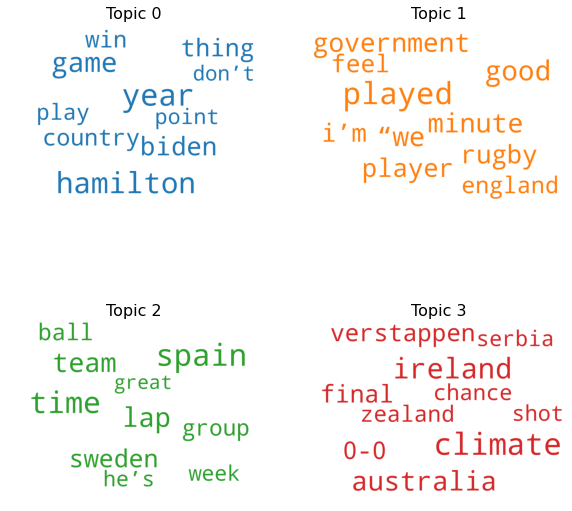

In [23]:
fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.savefig('secondnov.png')

###### cloud third december

In [9]:
cleantext=clean(Decemberthird)
cleanarray=np.array(cleantext)
listinlist=[]
for word in cleanarray:
    listinlist.append([word])
dictionary=corpora.Dictionary(listinlist)
doc_term_matrix=[dictionary.doc2bow(doc)for doc in listinlist]
lda=gensim.models.ldamodel.LdaModel
num_topics=4
ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=40,minimum_probability=0)
clouddec=ldamodel.print_topics(num_topics=num_topics)
clouddec

[(0,
  '0.011*"year" + 0.010*"time" + 0.009*"min" + 0.008*"day" + 0.007*"league" + 0.006*"good" + 0.006*"villa" + 0.005*"city" + 0.005*"england" + 0.005*"chelsea"'),
 (1,
  '0.006*"goal" + 0.005*"“the" + 0.005*"covid" + 0.005*"ball" + 0.004*"left" + 0.004*"shot" + 0.004*"social" + 0.004*"play" + 0.003*"“we" + 0.003*"family"'),
 (2,
  '0.007*"tutu" + 0.005*"west" + 0.004*"work" + 0.004*"don’t" + 0.004*"nh" + 0.004*"win" + 0.003*"public" + 0.003*"..." + 0.003*"point" + 0.003*"area"'),
 (3,
  '0.007*"game" + 0.006*"south" + 0.005*"player" + 0.005*"team" + 0.004*"“i" + 0.004*"feel" + 0.004*"number" + 0.003*"moment" + 0.003*"minute" + 0.003*"premier"')]

In [10]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()] 
cloud = WordCloud(
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

In [11]:
topics = ldamodel.show_topics(formatted=False)

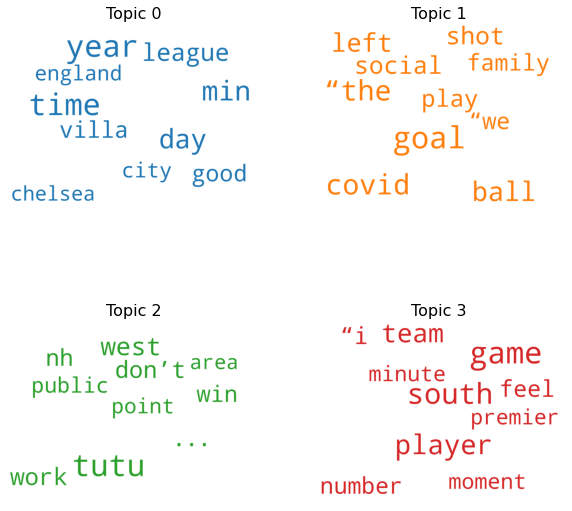

In [12]:
fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.savefig('thirddec.png')

###### cloud february first week

In [19]:
cleantext=clean(Februaryfirst)
cleanarray=np.array(cleantext)
listinlist=[]
for word in cleanarray:
    listinlist.append([word])
dictionary=corpora.Dictionary(listinlist)
doc_term_matrix=[dictionary.doc2bow(doc)for doc in listinlist]
lda=gensim.models.ldamodel.LdaModel
num_topics=4
ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=40,minimum_probability=0)
cloudfeb=ldamodel.print_topics(num_topics=num_topics)

In [20]:
cloudfeb

[(0,
  '0.015*"mins:" + 0.007*"team" + 0.005*"week" + 0.005*"place" + 0.004*"france" + 0.004*"national" + 0.004*"forest" + 0.004*"told" + 0.004*"including" + 0.004*"support"'),
 (1,
  '0.006*"egypt" + 0.005*"good" + 0.005*"long" + 0.005*"senegal" + 0.005*"johnson" + 0.004*"minister" + 0.004*"prime" + 0.004*"work" + 0.004*"it." + 0.003*"city"'),
 (2,
  '0.011*"time" + 0.006*"game" + 0.006*"ball" + 0.005*"number" + 0.005*"play" + 0.005*"country" + 0.004*"player" + 0.004*"left" + 0.004*"final" + 0.004*"“the"'),
 (3,
  '0.008*"year" + 0.006*"government" + 0.006*"day" + 0.005*"penalty" + 0.005*"win" + 0.005*"covid" + 0.004*"minute" + 0.004*"shot" + 0.004*"case" + 0.004*"“i"')]

In [23]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()] 
cloud = WordCloud(
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

In [24]:
topics = ldamodel.show_topics(formatted=False)

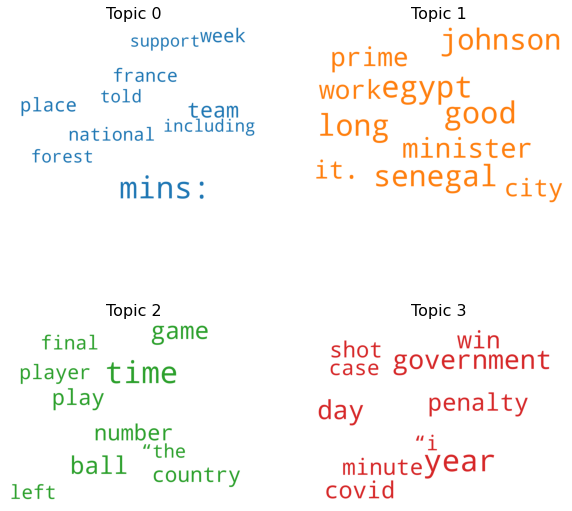

In [25]:
fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.savefig('firstfeb.png')

###### february word counts

In [26]:
from collections import Counter

In [29]:
cleantext=clean(Februarythird)
cleanarray=np.array(cleantext)
listinlist=[]
for word in cleanarray:
    listinlist.append([word])
dictionary=corpora.Dictionary(listinlist)
doc_term_matrix=[dictionary.doc2bow(doc)for doc in listinlist]
lda=gensim.models.ldamodel.LdaModel
num_topics=4
ldamodel=lda(doc_term_matrix,num_topics=num_topics,id2word=dictionary,passes=40,minimum_probability=0)
cloudfeb3=ldamodel.print_topics(num_topics=num_topics)
cloudfeb3

[(0,
  '0.006*"day" + 0.005*"good" + 0.005*"told" + 0.005*"week" + 0.004*"work" + 0.004*"left" + 0.004*"goal" + 0.004*"edward" + 0.004*"spain" + 0.003*"health"'),
 (1,
  '0.008*"england" + 0.005*"“i" + 0.005*"covid" + 0.004*"public" + 0.004*"suisse" + 0.004*"social" + 0.004*"medium" + 0.004*"government" + 0.004*"play" + 0.003*"account"'),
 (2,
  '0.009*"year" + 0.007*"mins:" + 0.005*"country" + 0.005*"thing" + 0.004*"shot" + 0.004*"win" + 0.004*"start" + 0.004*"bank" + 0.004*"point" + 0.003*"“the"'),
 (3,
  '0.010*"time" + 0.008*"ball" + 0.007*"team" + 0.007*"game" + 0.005*"including" + 0.005*"russian" + 0.005*"credit" + 0.004*"long" + 0.004*"died" + 0.004*"“we"')]

C:\Users\bened\AppData\Local\Temp\ipykernel_175340\3631073351.py:23: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
C:\Users\bened\AppData\Local\Temp\ipykernel_175340\3631073351.py:23: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
C:\Users\bened\AppData\Local\Temp\ipykernel_175340\3631073351.py:23: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
C:\Users\bened\AppData\Local\Temp\ipykernel_175340\3631073351.py:23: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')


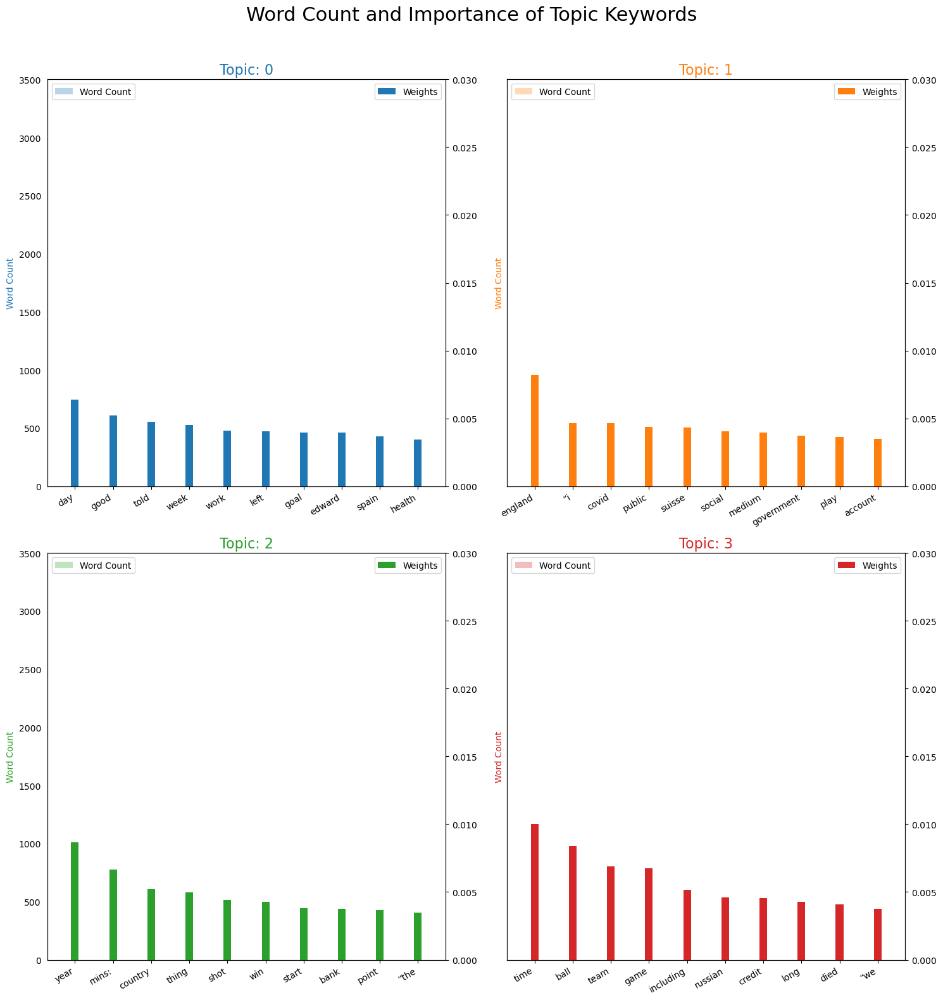

In [35]:
topics = ldamodel.show_topics(formatted=False)
data_flat = [w for w_list in Februarythird for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 2, figsize=(15,15), sharey=True, dpi=100)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()